# Library imports

In [1]:
from pyspark.sql import SparkSession
from pyspark import SparkContext as sc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import matplotlib as mpl
import os
import numpy as np
import pyspark.sql.functions as F
import matplotlib.style as style
import geopandas as gpd
import altair as alt
import json
import branca.colormap as cm
import folium
from folium.plugins import TimeSliderChoropleth

%matplotlib inline

# Data collection and processing 

We first created a Spark session to read the dataframe. We relied on Spark due to the large size of the registration dataframe.

In [2]:
# Start Spark session
spark = SparkSession \
    .builder \
    .master("local[*]") \
    .appName('NY Registration EDA') \
    .getOrCreate() 

# Specify filepath
fp = 'assets/ny_reg.csv'
ny_reg = spark.read.csv(fp, header=True)

We exluded the VIN numbers to protect confidentiality, then created a view for SQL manipulation.

In [3]:
ny_reg = ny_reg.select(np.array(ny_reg.columns)[np.array(ny_reg.columns) != 'VIN'].tolist())
ny_reg.createOrReplaceTempView("ny_reg")

In [4]:
ny_reg.first()

Row(Record Type='BOAT', Registration Class='BOT', City='RYE', State='NY', Zip='10580', County='WESTCHESTER', Model Year='1940', Make='FAIRF', Body Type='BOAT', Fuel Type='GAS', Unladen Weight=None, Maximum Gross Weight=None, Passengers=None, Reg Valid Date='03/10/2020', Reg Expiration Date='04/30/2023', Color=None, Scofflaw Indicator='N', Suspension Indicator='N', Revocation Indicator='N')

Our first query involved selecting only electric passenger vehicles and viewing only the top 10 results.

In [5]:
query = """
SELECT * FROM ny_reg
WHERE `Record Type` = 'VEH'
and `Registration Class` = 'PAS'
and `Fuel Type` = 'ELECTRIC'
"""
spark.sql(query).take(10)

[Row(Record Type='VEH', Registration Class='PAS', City='BUFFALO', State='NY', Zip='14207', County='ERIE', Model Year='1913', Make='DE/EL', Body Type='2DSD', Fuel Type='ELECTRIC', Unladen Weight='1100', Maximum Gross Weight=None, Passengers=None, Reg Valid Date='06/29/2020', Reg Expiration Date='07/01/2022', Color='MR', Scofflaw Indicator='N', Suspension Indicator='N', Revocation Indicator='N'),
 Row(Record Type='VEH', Registration Class='PAS', City='WILLIAMSVILLE', State='NY', Zip='14221', County='ERIE', Model Year='2021', Make='VOLVO', Body Type='4DSD', Fuel Type='ELECTRIC', Unladen Weight='4437', Maximum Gross Weight=None, Passengers=None, Reg Valid Date='12/28/2020', Reg Expiration Date='12/27/2022', Color='BK', Scofflaw Indicator='N', Suspension Indicator='N', Revocation Indicator='N'),
 Row(Record Type='VEH', Registration Class='PAS', City='PORTWASHINGTON', State='NY', Zip='11050', County='NASSAU', Model Year='2021', Make='VOLVO', Body Type='4DSD', Fuel Type='ELECTRIC', Unladen We

Next we found the unique registration classes represented by the data.

In [6]:
query = """
SELECT DISTINCT(`Registration Class`) FROM ny_reg
"""
spark.sql(query).take(10)

[Row(Registration Class='CCK'),
 Row(Registration Class='LMB'),
 Row(Registration Class='CLG'),
 Row(Registration Class='SOS'),
 Row(Registration Class='SPC'),
 Row(Registration Class='SUP'),
 Row(Registration Class='NYA'),
 Row(Registration Class='FAR'),
 Row(Registration Class='STA'),
 Row(Registration Class='RGL')]

We then found distinct record types.

In [7]:
query = """
SELECT DISTINCT(`Record Type`) FROM ny_reg
"""
spark.sql(query).take(10)

[Row(Record Type='BOAT'),
 Row(Record Type='VEH'),
 Row(Record Type='SNOW'),
 Row(Record Type='TRL')]

We extracted the registration year and the expiration year of the registration for further analysis.

In [8]:
ny_reg = ny_reg.withColumn('reg_year', F.regexp_extract(F.col('Reg Valid Date'), '\d{4}', 0))
ny_reg = ny_reg.withColumn('reg_exp_year', F.regexp_extract(F.col('Reg Expiration Date'), '\d{4}', 0))
ny_reg.createOrReplaceTempView("ny_reg")

We selected conventional and electric passenger cars, and created views of these datasets.

In [9]:
query = """
SELECT * FROM ny_reg
WHERE `Record Type`='VEH' 
AND `Fuel Type` = 'GAS' 
AND `Registration Class` = 'PAS'
"""
conv_pass = spark.sql(query)

In [10]:
query = """
SELECT * FROM ny_reg
WHERE `Record Type`='VEH' 
AND `Fuel Type` = 'ELECTRIC'
AND `Registration Class` = 'PAS'
"""
elec_pass = spark.sql(query)

In [11]:
conv_pass.createOrReplaceTempView("conv_pass")
elec_pass.createOrReplaceTempView("elec_pass")

# Vehicle registrations by make

We first wanted to find what the top makes for registered vehicles were for conventional and electric passenger cars. We found the top conventional vehicle makes and sorted by the number of registrations. Then we converted these results to a Pandas dataframe.

In [12]:
query = """
SELECT COUNT(*) count, Make, reg_year FROM conv_pass
GROUP BY Make, reg_year
ORDER BY count DESC
"""
top_conv_veh = pd.DataFrame([x.asDict() for x in spark.sql(query).collect()])

We then created a dataframe with the number of registrations by make for electric vehicles.

In [13]:
query = """
SELECT COUNT(*) count, Make, reg_year FROM elec_pass
GROUP BY Make, reg_year
ORDER BY count DESC
"""
top_elec_veh = pd.DataFrame([x.asDict() for x in spark.sql(query).collect()])

We first looked at all EV makes. Tesla had by far the highest number of EV registrations across all years.

Text(0.41, 0.95, 'EV registrations in NY by year registered and make')

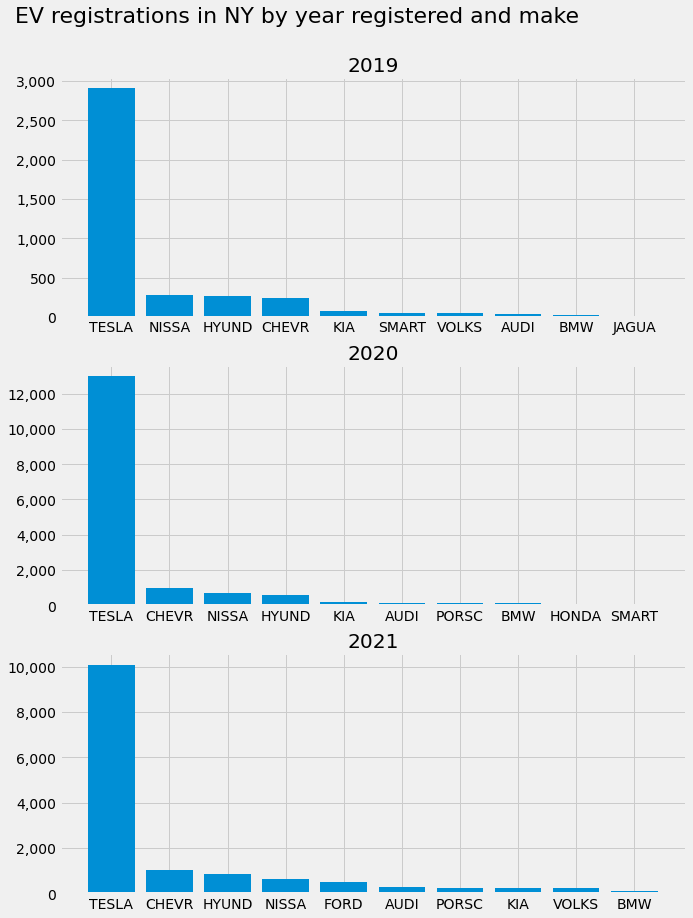

In [14]:
style.use('fivethirtyeight')
fig, ax = plt.subplots(3, 1, figsize=(10, 14))
years = np.sort(top_elec_veh['reg_year'].unique())

for i in range(years.shape[0]):
    year = years[i]
    top_10_elec = (top_elec_veh.loc[top_elec_veh['reg_year'] == year]
    .sort_values('count', ascending=False)
    .iloc[:10]
    )
    ax[i].bar(top_10_elec['Make'].values, top_10_elec['count'].values)
    ax[i].yaxis.set_major_formatter(mpl.ticker.FuncFormatter(lambda x, a: '{:,.0f}'.format(x)))
    ax[i].set_title(year)
fig.suptitle('EV registrations in NY by year registered and make', 
x=0.41, y=0.95, fontsize=22)

We then chose to focus only on non-Tesla makes given the high number of Tesla registrations. Nissan, Hyundai, and Chevrolet has the highest number of EV registrations across all three years.

Text(0.28, 0.95, 'Non-Tesla EV registrations in NY')

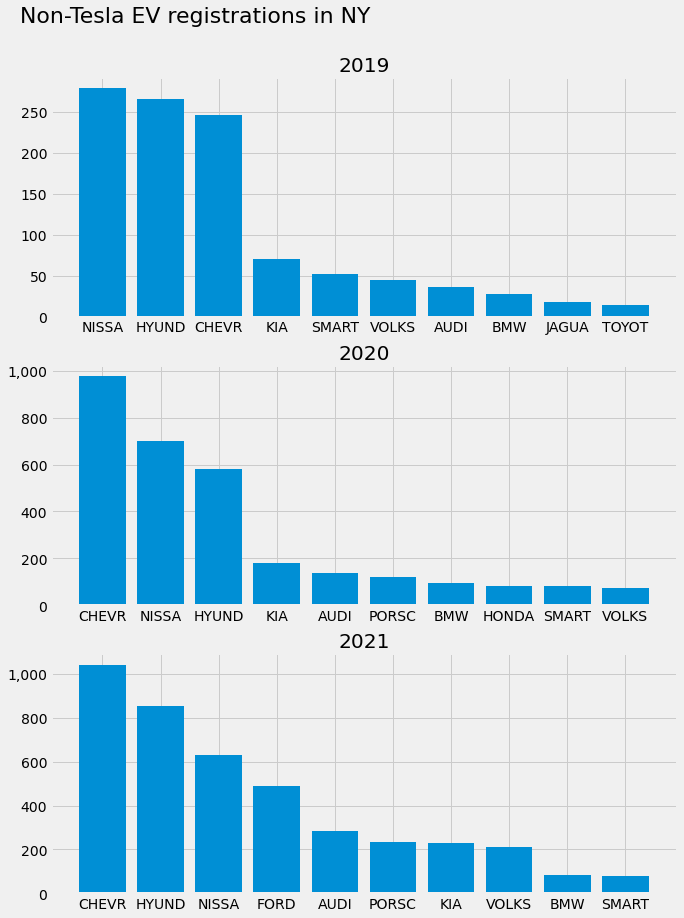

In [15]:
fig, ax = plt.subplots(3, 1, figsize=(10, 14))
top_non_tesla = top_elec_veh.loc[top_elec_veh['Make'] != 'TESLA']
years = np.sort(top_non_tesla['reg_year'].unique())

for i in range(years.shape[0]):
    year = years[i]
    top_10_non = (top_non_tesla.loc[top_non_tesla['reg_year'] == year]
    .sort_values('count', ascending=False)
    .iloc[:10]
    )
    ax[i].bar(top_10_non['Make'].values, top_10_non['count'].values)
    ax[i].yaxis.set_major_formatter(mpl.ticker.FuncFormatter(lambda x, a: '{:,.0f}'.format(x)))
    ax[i].set_title(year)
fig.suptitle('Non-Tesla EV registrations in NY', 
x=0.28, y=0.95, fontsize=22)

Next we looked at conventional vehicle registrations. Toyota, Honda, and Chevrolet has the highest number of CV registration across all three years. Only Chevrolet was in the top 3 makes for EV's and CV's.

Text(0.39, 0.95, 'CV registrations in NY by year registered and make')

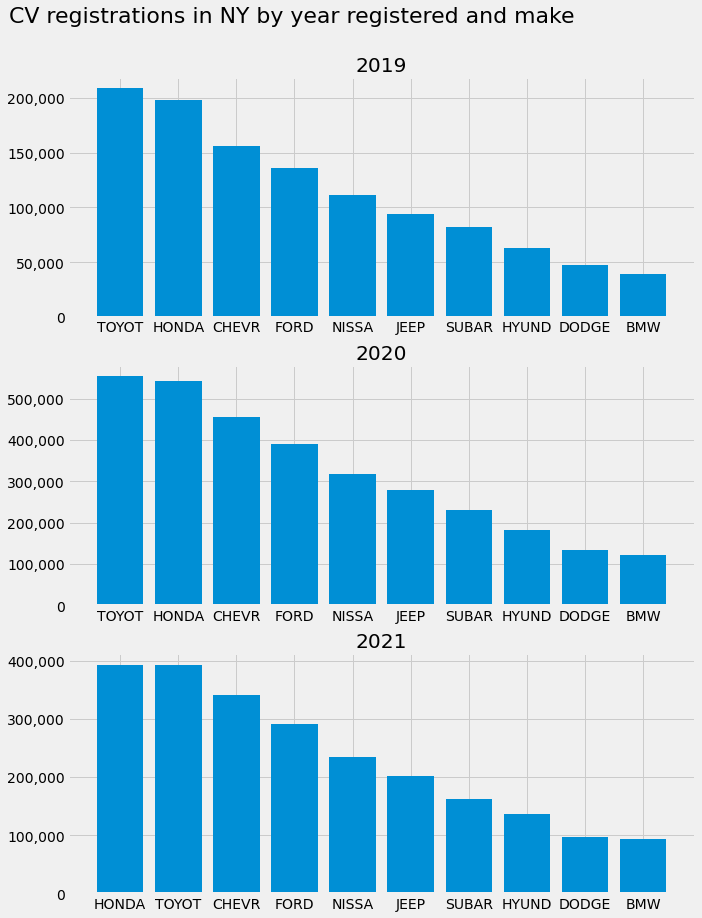

In [16]:
fig, ax = plt.subplots(3, 1, figsize=(10, 14))
years = np.sort(top_conv_veh['reg_year'].unique())[1:]

for i in range(years.shape[0]):
    year = years[i]
    top_10_conv = (top_conv_veh.loc[top_conv_veh['reg_year'] == year]
    .sort_values('count', ascending=False)
    .iloc[:10]
    )
    ax[i].bar(top_10_conv['Make'].values, top_10_conv['count'].values)
    ax[i].yaxis.set_major_formatter(mpl.ticker.FuncFormatter(lambda x, a: '{:,.0f}'.format(x)))
    ax[i].set_title(year)
fig.suptitle('CV registrations in NY by year registered and make', 
x=0.39, y=0.95, fontsize=22)

# Vehicle registrations by body type

Next, we looked at vehicle registrations by body type to see if there are any trends in type of vehicle registered. We grouped by body type, make, and date in the EV datarame to find EV registrations by these factors.

In [17]:
query = """
SELECT `Body Type` body, `Reg Valid Date` date, Make, COUNT(*) count FROM elec_pass
GROUP BY body, date, Make
"""

elec_body = pd.DataFrame([x.asDict() for x in spark.sql(query).collect()])

In [18]:
elec_body.head()

,body,date,Make,count
0,4DSD,06/04/2020,TESLA,12
1,4DSD,06/25/2021,TESLA,44
2,4DSD,09/21/2019,TESLA,19
3,4DSD,02/16/2021,TESLA,18
4,4DSD,05/07/2021,TESLA,24


Next we grouped by date and body, then converted the date to a Pandas datetime object.

In [19]:
elec_body_daily = elec_body.groupby(['date', 'body']).sum().iloc[:, 0].reset_index()
elec_body_daily.columns = ['date', 'body', 'count']
elec_body_daily['date'] = pd.to_datetime(elec_body_daily['date'], format='%m/%d/%Y')

We first compared four-door sedans to suburbans because these are the most common body type. Initially fewer suburbans were registered. However, in 2021 the number of registrations for each have been very similar. The line chart is shown for 7-day average registrations.

Text(0.0, 1.0, 'EVs registered in NY by body type for suburbans and four-door sedans')

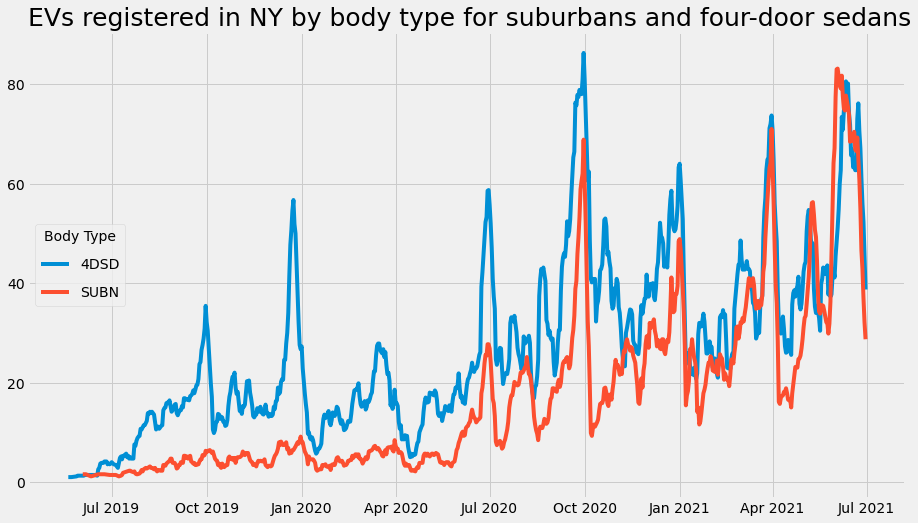

In [20]:
elec_body_sd_subn = elec_body_daily.loc[elec_body_daily['body'].isin(['4DSD', 'SUBN'])]
bodies = elec_body_sd_subn['body'].unique()
fig, ax = plt.subplots(1, 1, figsize=(14, 8))
for body in bodies:
    elec_body_part = elec_body_sd_subn.loc[elec_body_sd_subn['body'] == body].copy()
    elec_body_part.sort_values('date', inplace=True)
    elec_body_part['reg_7day'] = elec_body_part['count'].rolling(7).mean()
    ax.plot(elec_body_part['date'].values, elec_body_part['reg_7day'].values, label=body)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%b %Y'))
ax.legend(title='Body Type', labelspacing=1, loc='center left')
ax.set_title('EVs registered in NY by body type for suburbans and four-door sedans', 
loc='left', fontsize=25)

Next, other body types were compared. Many sedans were registered in early 2021. However, the number of new registrations dropped around March 2021.

Text(0.0, 1.0, 'EVs registered in NY by body type for other body types')

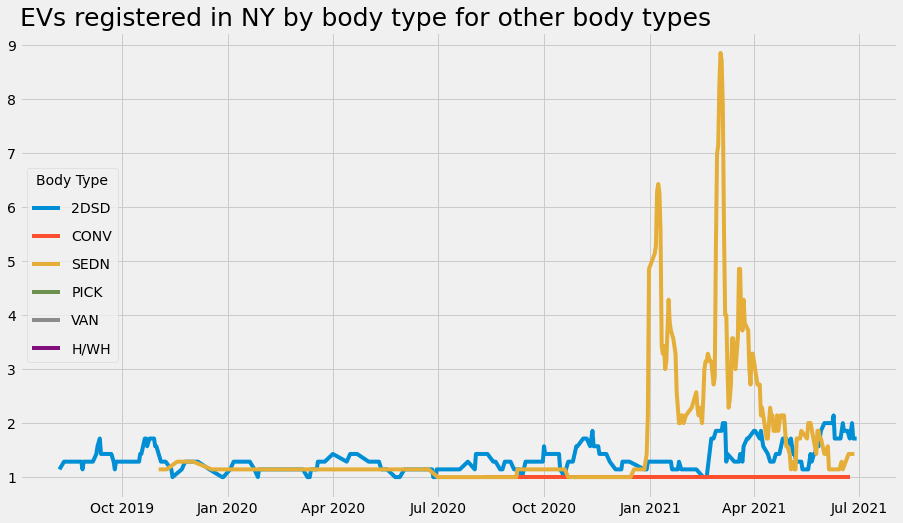

In [21]:
elec_body_other = elec_body_daily.loc[~elec_body_daily['body'].isin(['4DSD', 'SUBN'])]
bodies = elec_body_other['body'].unique()
fig, ax = plt.subplots(1, 1, figsize=(14, 8))
for body in bodies:
    elec_body_part = elec_body_other.loc[elec_body_other['body'] == body].copy()
    elec_body_part.sort_values('date', inplace=True)
    elec_body_part['reg_7day'] = elec_body_part['count'].rolling(7).mean()
    ax.plot(elec_body_part['date'].values, elec_body_part['reg_7day'].values, label=body)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%b %Y'))
ax.legend(title='Body Type', labelspacing=1, loc='center left')
ax.set_title('EVs registered in NY by body type for other body types', 
loc='left', fontsize=25)

# Time Series Data

Next, we analyzed the number of registrations by registration date. The first step was to group by registration date for Tesla and non-Tesla EV's.

In [22]:
query = """
SELECT `Reg Valid Date`, COUNT(*) num_reg FROM elec_pass
WHERE Make = 'TESLA'
GROUP BY `Reg Valid Date`
"""
tesla = spark.sql(query)

In [23]:
query = """
SELECT `Reg Valid Date`, COUNT(*) num_reg FROM elec_pass
WHERE Make != 'TESLA'
GROUP BY `Reg Valid Date`
"""
elec_non_tesla = spark.sql(query)

Next, we used the results of our SQL query to create Pandas dataframes.

In [24]:
tesla_by_date = pd.DataFrame([x.asDict() for x in tesla.collect()])
elec_by_date = pd.DataFrame([x.asDict() for x in elec_non_tesla.collect()])

Next, we converted the registation date column to datetime format.

In [25]:
elec_by_date['Reg Valid Date'] = pd.to_datetime(elec_by_date['Reg Valid Date'], format='%m/%d/%Y')
tesla_by_date['Reg Valid Date'] = pd.to_datetime(tesla_by_date['Reg Valid Date'], format='%m/%d/%Y')

We then renamed the columns, sorted by registration date, and found the cumulative sum of registrations for both Tesla and non-Tesla EVs.

In [26]:
elec_by_date.columns = ['reg_date', 'reg_count']
elec_by_date.sort_values('reg_date', inplace=True)
elec_by_date['reg_count_cum'] = elec_by_date['reg_count'].cumsum()

In [27]:
tesla_by_date.columns = ['reg_date', 'reg_count']
tesla_by_date.sort_values('reg_date', inplace=True)
tesla_by_date['reg_count_cum'] = tesla_by_date['reg_count'].cumsum()

Our first visualization is cumulative registrations for non-Tesla EVs. The number of registered vehicles appears to be accelarating, indicating that the number of newly registered non-Tesla EV's is increasing.

Text(0.0, 1.0, 'Cumulative registrations of non-Tesla EVs')

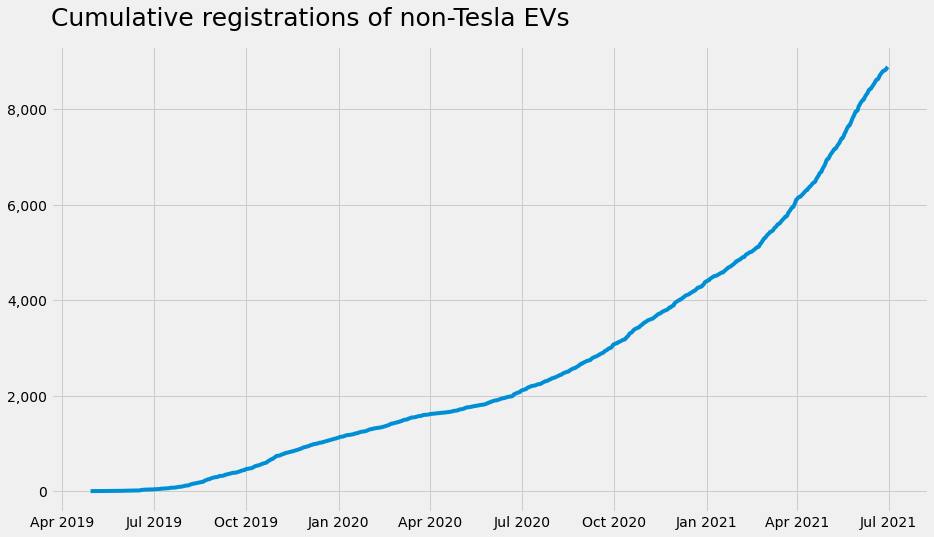

In [28]:
style.use('fivethirtyeight')
fig, ax = plt.subplots(1, 1, figsize=(14, 8))
ax.plot(elec_by_date['reg_date'].values, elec_by_date['reg_count_cum'].values)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%b %Y'))
ax.yaxis.set_major_formatter(mpl.ticker.FuncFormatter(lambda x, a: '{:,.0f}'.format(x)))
ax.set_title('Cumulative registrations of non-Tesla EVs', loc='left', fontsize=25, pad=20)

Cumulative registrations for Tesla vehicles appear to have a linear trend from October 2020 onwards, indicating that registrations may not be increasing. However, the number of registrations is far higher than for non-Tesla EVs.

Text(0.0, 1.0, 'Cumulative registrations of Tesla EVs')

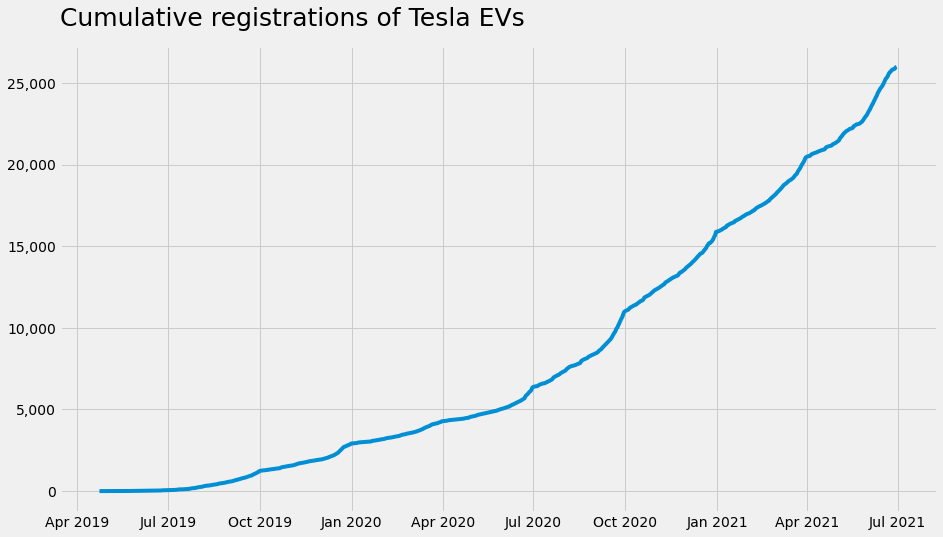

In [29]:
style.use('fivethirtyeight')
fig, ax = plt.subplots(1, 1, figsize=(14, 8))
ax.plot(tesla_by_date['reg_date'].values, tesla_by_date['reg_count_cum'].values)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%b %Y'))
ax.yaxis.set_major_formatter(mpl.ticker.FuncFormatter(lambda x, a: '{:,.0f}'.format(x)))
ax.set_title('Cumulative registrations of Tesla EVs', loc='left', fontsize=25, pad=20)

Next, we found the 7-day averages for new vehicle registrations. First we visulized the trend in this average for Tesla vehicles. This trend is very noisy indicating that Tesla registrations occur in inconsistent bursts. Perhaps vehicle owever think of re-registering their cars during in waves.

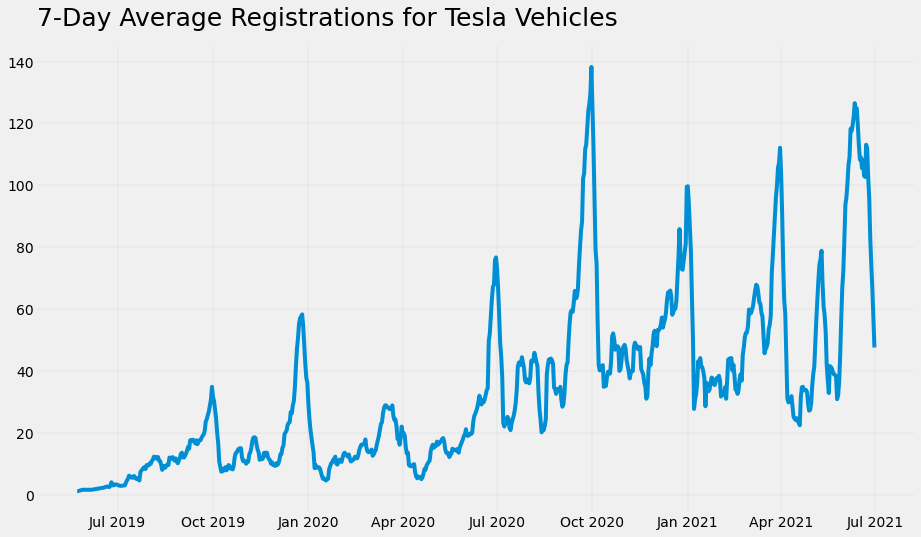

In [30]:
tesla_by_date['reg_count_7day'] = tesla_by_date['reg_count'].rolling(7).mean()

fig, ax = plt.subplots(1, 1, figsize=(14, 8))
ax.plot(tesla_by_date['reg_date'].values, tesla_by_date['reg_count_7day'].values)
myFmt = mdates.DateFormatter('%b %Y')
ax.xaxis.set_major_formatter(myFmt)
ax.spines['left'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.grid(b=True, linewidth=0.3)
ax.tick_params(width=0)
ax.set_title('7-Day Average Registrations for Tesla Vehicles', loc='left', fontsize=25, pad=20)
ax.set_facecolor('#EFF0EF')
fig.patch.set_facecolor('#EFF0EF')

On the other hand, new registrations for non-Tesla EV's have a clear upward trend, especially from April 2020 to May 2021. After May 2021 the number of new registrations dropped dramatically, likely owing to a chip shortage.

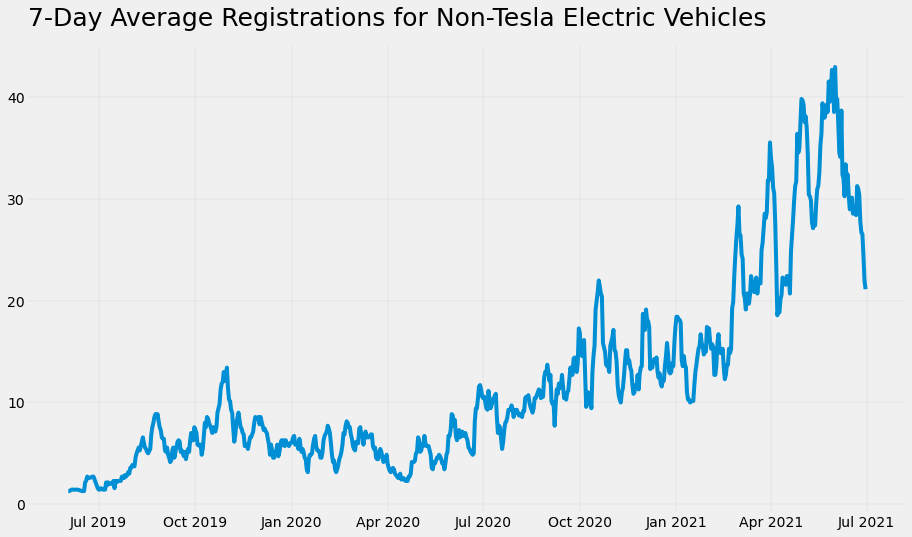

In [31]:
elec_by_date['reg_count_7day'] = elec_by_date['reg_count'].rolling(7).mean()
fig, ax = plt.subplots(1, 1, figsize=(14, 8))
ax.plot(elec_by_date['reg_date'].values, elec_by_date['reg_count_7day'].values)
myFmt = mdates.DateFormatter('%b %Y')
ax.xaxis.set_major_formatter(myFmt)
ax.spines['left'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.grid(b=True, linewidth=0.3)
ax.tick_params(width=0)
ax.set_title('7-Day Average Registrations for Non-Tesla Electric Vehicles', loc='left', fontsize=25, pad=20)
ax.set_facecolor('#EFF0EF')
fig.patch.set_facecolor('#EFF0EF')

We then looked into trends in conventional vehicle registrations. First we grouped by registration date and obtained the number of new registrations by date.

In [32]:
query = """
SELECT `Reg Valid Date` reg_date, COUNT(*) veh_count FROM conv_pass
GROUP BY `Reg Valid Date`
"""

conv_count = pd.DataFrame([x.asDict() for x in spark.sql(query).collect()])

In [33]:
conv_pass.first()

Row(Record Type='VEH', Registration Class='PAS', City='SARATOGA SPRIN', State='NY', Zip='12866', County='SARATOGA', Model Year='1976', Make='LA/RO', Body Type='SUBN', Fuel Type='GAS', Unladen Weight='3500', Maximum Gross Weight=None, Passengers=None, Reg Valid Date='03/03/2021', Reg Expiration Date='05/12/2023', Color='WH', Scofflaw Indicator='N', Suspension Indicator='N', Revocation Indicator='N', reg_year='2021', reg_exp_year='2023')

We then converted the registration date to datetime format, sorted by registration date, and calculated the 7-day new registration average. The resulting plot is shown below. New registrations are increasing, but seem to resemble a step pattern. The number of new registrations is not growing as quickly as for EVs, but the number of new registrations is far higher.

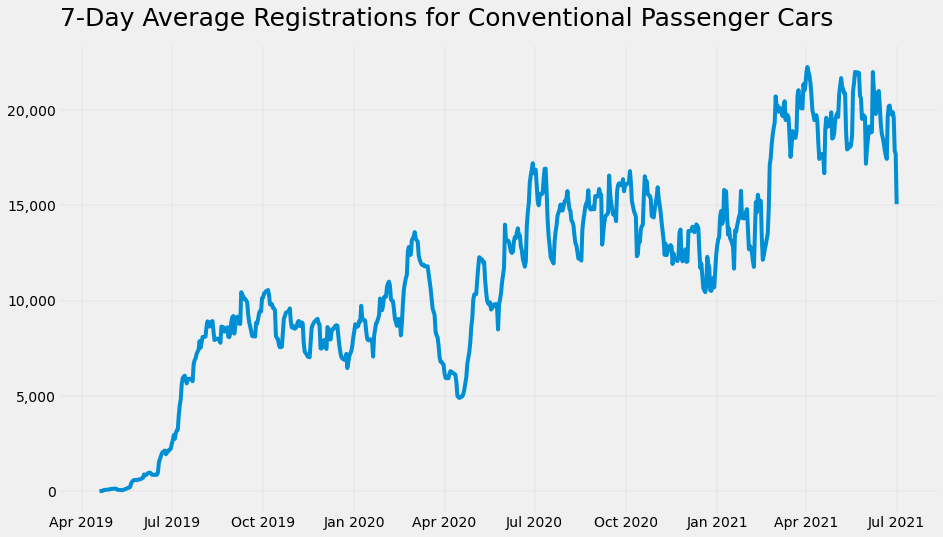

In [34]:
conv_count['reg_date'] = pd.to_datetime(conv_count['reg_date'], format='%m/%d/%Y')
conv_count.sort_values('reg_date', inplace=True)
conv_count['reg_count_7day'] = conv_count['veh_count'].rolling(7).mean()
fig, ax = plt.subplots(1, 1, figsize=(14, 8))
ax.plot(conv_count['reg_date'].values, conv_count['reg_count_7day'].values)
myFmt = mdates.DateFormatter('%b %Y')
ax.xaxis.set_major_formatter(myFmt)
ax.spines['left'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.grid(b=True, linewidth=0.3)
ax.tick_params(width=0)
ax.yaxis.set_major_formatter(mpl.ticker.FuncFormatter(lambda x, p: format(int(x), ',')))
ax.set_title('7-Day Average Registrations for Conventional Passenger Cars', loc='left', fontsize=25, pad=20)
ax.set_facecolor('#EFF0EF')
fig.patch.set_facecolor('#EFF0EF')

In [35]:
elec_pass.first()

Row(Record Type='VEH', Registration Class='PAS', City='BUFFALO', State='NY', Zip='14207', County='ERIE', Model Year='1913', Make='DE/EL', Body Type='2DSD', Fuel Type='ELECTRIC', Unladen Weight='1100', Maximum Gross Weight=None, Passengers=None, Reg Valid Date='06/29/2020', Reg Expiration Date='07/01/2022', Color='MR', Scofflaw Indicator='N', Suspension Indicator='N', Revocation Indicator='N', reg_year='2020', reg_exp_year='2022')

# Registrations by Model Year and Make

We then sought to aggregrate the data by model year and make. The first step was to group the dataframe for EVs by these columns as well as body type.

In [36]:
query = """
SELECT COUNT(*) num_reg, `Model Year` model_year, `Body Type` body_type, Make make FROM elec_pass
GROUP BY `Model Year`, `Body Type`, Make
ORDER BY num_reg DESC
"""
elec_model_body = pd.DataFrame([x.asDict() for x in spark.sql(query).collect()])

In [37]:
elec_model_body.head()

,num_reg,model_year,body_type,make
0,5294,2021,SUBN,TESLA
1,4063,2020,4DSD,TESLA
2,3900,2018,4DSD,TESLA
3,2915,2019,4DSD,TESLA
4,2875,2020,SUBN,TESLA


We first looked at registrations of EV's by model year and make. The number of registrations of Tesla vehicles has increased greatly between 2015 and 2021. The number of registrations for Tesla vehicles far exceeds the number of registrations for non-Tesla EVs in this timespan.

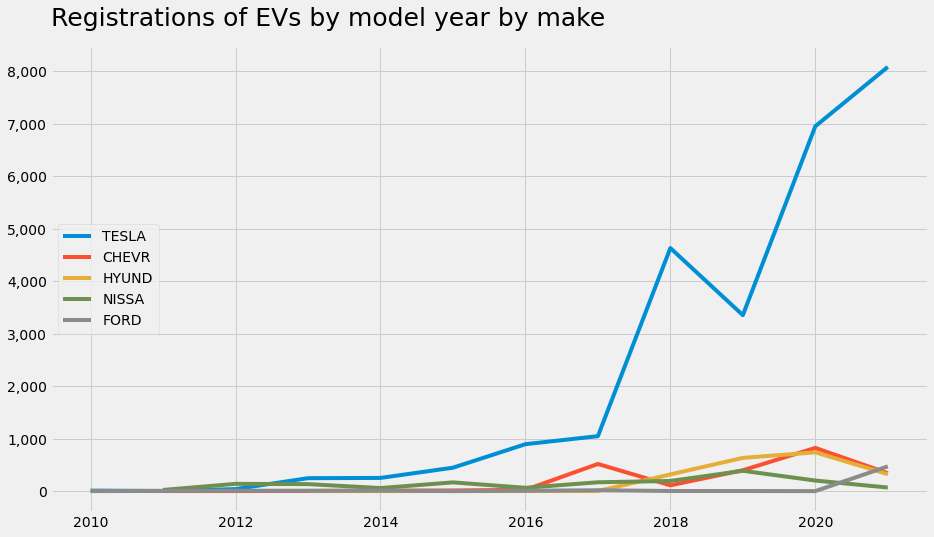

In [38]:
style.use('fivethirtyeight')

top_makes = (elec_model_body[['num_reg', 'make']]
.groupby('make')
.sum()
.sort_values('num_reg', ascending=False)
.index[:5]
.tolist()
)
elec_model_body['model_year'] = elec_model_body['model_year'].astype(int)
fig, ax = plt.subplots(1, 1, figsize=(14, 8))
for make in top_makes:
    df = elec_model_body.loc[elec_model_body['make'] == make]
    df = df.groupby('model_year')['num_reg'].sum().reset_index()
    df = df.loc[(df['model_year'] >= 2010) & (df['model_year'] <= 2021)]
    ax.plot(df['model_year'].values, df['num_reg'].values, label=make)
ax.legend(loc='center left')
ax.set_title('Registrations of EVs by model year by make', loc='left', fontsize=25, pad=20)
ax.yaxis.set_major_formatter(mpl.ticker.FuncFormatter(lambda x, a: '{:,.0f}'.format(x)))

We then chose the top four makes excluding Tesla. Chevrolet and Hyundai had the highest sales in 2019 and 2020. However, EV sales of Ford vehicles jumped in 2021 as more Ford EVs were available.

Text(0.0, 1.0, 'Registrations of non-Tesla EVs by model year and make')

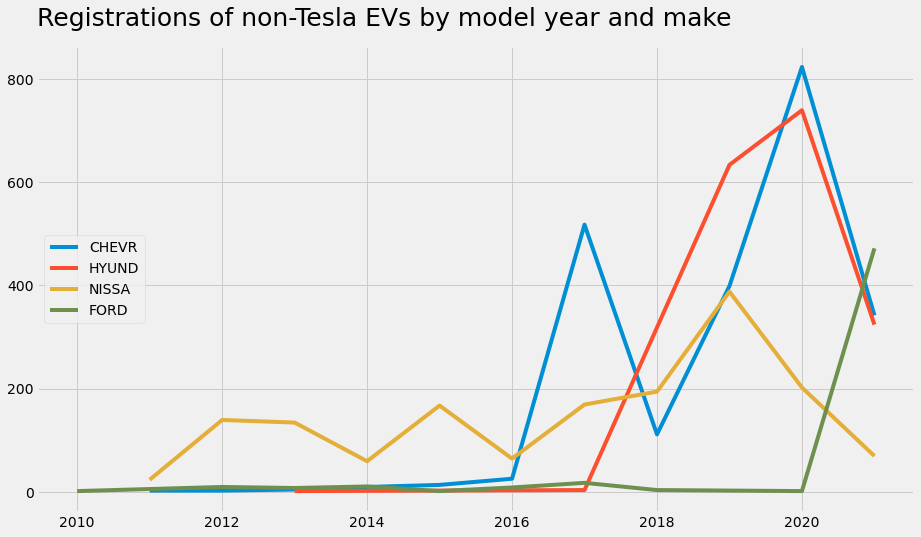

In [39]:
top_make_non_tesla = top_makes[1:]
elec_model_body['model_year'] = elec_model_body['model_year'].astype(int)
fig, ax = plt.subplots(1, 1, figsize=(14, 8))
for make in top_make_non_tesla:
    df = elec_model_body.loc[elec_model_body['make'] == make]
    df = df.groupby('model_year')['num_reg'].sum().reset_index()
    df = df.loc[(df['model_year'] >= 2010) & (df['model_year'] <= 2021)]
    ax.plot(df['model_year'].values, df['num_reg'].values, label=make)
ax.legend(loc='center left')
ax.set_title('Registrations of non-Tesla EVs by model year and make', loc='left', fontsize=25, pad=20)

In [40]:
elec_pass.first()

Row(Record Type='VEH', Registration Class='PAS', City='BUFFALO', State='NY', Zip='14207', County='ERIE', Model Year='1913', Make='DE/EL', Body Type='2DSD', Fuel Type='ELECTRIC', Unladen Weight='1100', Maximum Gross Weight=None, Passengers=None, Reg Valid Date='06/29/2020', Reg Expiration Date='07/01/2022', Color='MR', Scofflaw Indicator='N', Suspension Indicator='N', Revocation Indicator='N', reg_year='2020', reg_exp_year='2022')

We created separate dataframes for Tesla and non-Tesla EVs. They both grouped by record type, registration year, and Make.

In [41]:
query = """
SELECT `Record Type`, reg_year, COUNT(*) count, Zip FROM elec_pass
GROUP BY Make, reg_year, Zip, `Record Type`
HAVING Make = 'TESLA'
"""
tesla_df = pd.DataFrame([x.asDict() for x in spark.sql(query).collect()])

In [42]:
query = """
SELECT `Record Type`, Make, reg_year, COUNT(*) count, Zip FROM elec_pass
GROUP BY Make, reg_year, Zip, `Record Type`
HAVING Make != 'TESLA'
"""
elec_non_tesla_df = pd.DataFrame([x.asDict() for x in spark.sql(query).collect()])

# Geospatial Data

We next wanted to visualize the data using mapping. We found the number of registrations by zip and registration year for both dataframes.

In [43]:
elec_non_tesla_zip_year = (elec_non_tesla_df
.groupby(['Zip', 'reg_year'])['count']
.sum()
.reset_index()
.sort_values('count', ascending=False))

In [44]:
tesla_zip_year = (tesla_df
.groupby(['Zip', 'reg_year'])['count']
.sum()
.reset_index()
.sort_values('count', ascending=False))

Next, we uploaded the Zipcode shapefile for the US using GeoPandas.

In [45]:
us_zip_shp = gpd.read_file('assets/us_zipcodes/cb_2018_us_zcta510_500k.shp')

In [46]:
us_zip_shp.columns

Index(['ZCTA5CE10', 'AFFGEOID10', 'GEOID10', 'ALAND10', 'AWATER10',
       'geometry'],
      dtype='object')

We then merged the Zip Code shapefiles with the registration data for non-Tesla EVs, and reconfigured the data as a GeoDataFrame.

In [47]:
elec_non_zip_geom = pd.merge(elec_non_tesla_zip_year, us_zip_shp, left_on='Zip', right_on='ZCTA5CE10', how='left')
elec_non_zip_geom = gpd.GeoDataFrame(elec_non_zip_geom, geometry='geometry')

We then filtered the Zip Codes by only those within New York City. This was based on the first three digits of the Zip Code.

In [48]:
elec_non_zip_geom['zip_start'] = elec_non_zip_geom['Zip'].map(lambda x: int(x[:3]))
elec_non_zip_geom = elec_non_zip_geom.loc[(elec_non_zip_geom['zip_start'] > 99) & 
(elec_non_zip_geom['zip_start'] < 150)]

In [49]:
elec_non_zip_geom.columns

Index(['Zip', 'reg_year', 'count', 'ZCTA5CE10', 'AFFGEOID10', 'GEOID10',
       'ALAND10', 'AWATER10', 'geometry', 'zip_start'],
      dtype='object')

We used the GeoPandas plot feature to get a preliminary view of registrations by Zip Code.

No handles with labels found to put in legend.


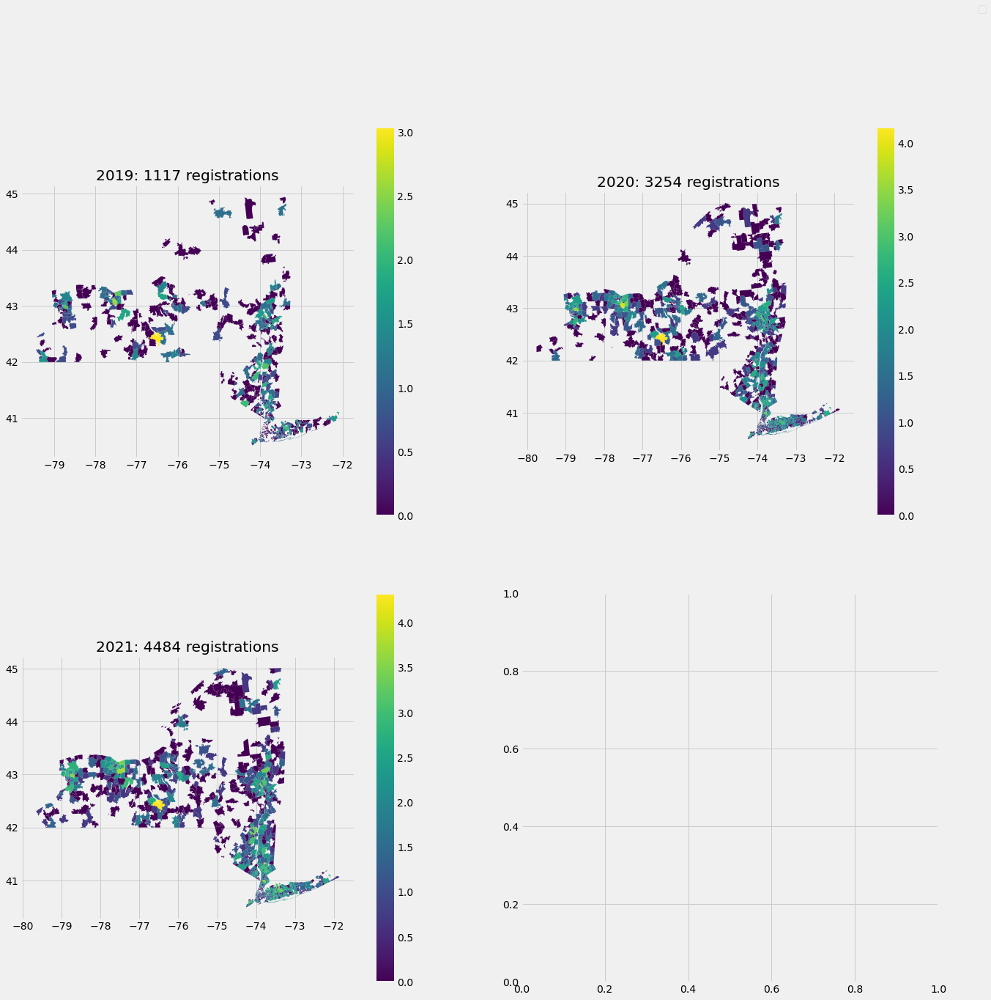

In [50]:
years = np.sort(elec_non_zip_geom.reg_year.unique())
fig, axes = plt.subplots(2, 2, figsize=(20, 20))
for i in range(years.shape[0]):
    year = years[i]
    elec_year = elec_non_zip_geom.loc[elec_non_zip_geom['reg_year'] == year].copy()
    elec_sum = elec_year['count'].sum()
    elec_year['count'] = np.log(elec_year['count'])
    j = i // 2
    k = i % 2
    elec_year.plot(column='count', ax=axes[j,k], legend=True)
    axes[j, k].set_title("{}: {} registrations".format(year, elec_sum))
fig.legend()

We converted the non-Tesla EV Zip Code dataframe into a geojson file to aid in plotting with Folium.

In [51]:
us_zip_geojson = json.loads(elec_non_zip_geom.to_json())

In [52]:
elec_non_zip_geom.head()

,Zip,reg_year,count,ZCTA5CE10,AFFGEOID10,GEOID10,ALAND10,AWATER10,geometry,zip_start
0,14850,2021,76,14850,8600000US14850,14850,326240899.0,2256411.0,"MULTIPOLYGON (((-76.43289 42.51260, -76.43022 ...",148
1,14850,2020,65,14850,8600000US14850,14850,326240899.0,2256411.0,"MULTIPOLYGON (((-76.43289 42.51260, -76.43022 ...",148
2,14534,2020,51,14534,8600000US14534,14534,83743576.0,780447.0,"POLYGON ((-77.59301 43.05953, -77.58807 43.068...",145
3,14450,2021,45,14450,8600000US14450,14450,82373231.0,789468.0,"POLYGON ((-77.47949 43.10241, -77.47790 43.102...",144
4,10583,2021,42,10583,8600000US10583,10583,32018618.0,97925.0,"POLYGON ((-73.84546 40.98351, -73.84051 40.988...",105


We then created a colormap and a style dictionary to aid in our Folium plot.

In [53]:
elec_non_zip_geom['date'] = pd.to_datetime(elec_non_zip_geom['reg_year'], format='%Y').astype(int).div(1e9).add(1).astype(str)
elec_non_zip_geom['log_cases'] = np.log(elec_non_zip_geom['count'])
cmap = cm.linear.YlOrRd_09.scale(elec_non_zip_geom['log_cases'].min(), elec_non_zip_geom['log_cases'].max())
elec_non_zip_geom['color'] = elec_non_zip_geom['log_cases'].map(cmap)
zip_codes = sorted(elec_non_zip_geom['Zip'].unique())
style_dct = {}

for i in range(len(zip_codes)):
    zip_code = zip_codes[i]
    result = elec_non_zip_geom.loc[elec_non_zip_geom['Zip'] == zip_code]
    inner_dict = {}
    for _, r in result.iterrows():
        inner_dict[r['date']] = {'color': r['color'], 'opacity': 0.7}
    style_dct[str(i)] = inner_dict

The next maps that we created were for new EV registrations by year. The number of new registrations increased each year from 2019 to 2021.

In [54]:
time_m = folium.Map((42.3, -74), zoom_start=6)

TimeSliderChoropleth(
    data=elec_non_zip_geom.to_json(),
    styledict=style_dct,
    name='time_choro'


).add_to(time_m)
time_m

Next we grouped by the Zip Code to get the total number of registrations by Zip.

In [55]:
full_elec = gpd.GeoDataFrame(elec_non_zip_geom.groupby('Zip')
.agg({'count': 'sum', 'geometry': 'first'}).reset_index(), geometry='geometry')
full_elec_geojson = json.loads(full_elec.to_json())

We took the log of the number of registrations to aid in distinguishing different areas by color.

In [56]:
full_elec['log_count'] = np.log(full_elec['count'])

Next we created a map of the log of total registrations by Zip Code.

In [57]:
full_elec_m = folium.Map((42.3, -74), zoom_start=7)
choropleth = folium.Choropleth(
    geo_data=full_elec_geojson,
    name="choropleth",
    data=full_elec,
    columns=["Zip", "log_count"],
    key_on="feature.properties.Zip",
    fill_color="OrRd",
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="Log of total registrations for non-Tesla electric vehicles",
)
choropleth.add_to(full_elec_m)

Next we created the same visualizations for Tesla EVs. First we merged the Tesla dataframe with the zipcode shapefile and reformed the combined dataframe into a GeoDataFrame.

In [58]:
tesla_zip_geom = pd.merge(tesla_zip_year, us_zip_shp, left_on='Zip', right_on='ZCTA5CE10', how='left')
tesla_zip_geom = gpd.GeoDataFrame(tesla_zip_geom, geometry='geometry')

We then similarly created a colormap and style dictionary for the visualization showing new registrations by year.

In [59]:
tesla_zip_geom['date'] = pd.to_datetime(tesla_zip_geom['reg_year'], format='%Y').astype(int).div(1e9).add(1).astype(str)
tesla_zip_geom['log_cases'] = np.log(tesla_zip_geom['count'])
cmap = cm.linear.YlOrRd_09.scale(tesla_zip_geom['log_cases'].min(), tesla_zip_geom['log_cases'].max())
tesla_zip_geom['color'] = tesla_zip_geom['log_cases'].map(cmap)
zip_codes = sorted(tesla_zip_geom['Zip'].unique())
style_dct_tesla = {}

for i in range(len(zip_codes)):
    zip_code = zip_codes[i]
    result = tesla_zip_geom.loc[tesla_zip_geom['Zip'] == zip_code]
    inner_dict = {}
    for _, r in result.iterrows():
        inner_dict[r['date']] = {'color': r['color'], 'opacity': 0.7}
    style_dct_tesla[str(i)] = inner_dict

We then created the same style map of registrations by year and Zip Code for Tesla vehicles. Tesla registrations are mainly concentrated in NYC and the Hudson Valley region.

In [60]:
time_m_tesla = folium.Map((42.3, -74), zoom_start=6)

TimeSliderChoropleth(
    data=tesla_zip_geom.to_json(),
    styledict=style_dct_tesla,
    name='time_choro'


).add_to(time_m_tesla)
time_m_tesla

We then grouped Tesla registrations by Zip Code to get total registrations by Zip Code. We reformed the grouped dataframe into a GeoDataFrame and converted to a geojson.

In [61]:
tesla_elec = tesla_zip_geom.groupby('Zip').agg({'count': 'sum', 'geometry': 'first'}).reset_index()
tesla_elec = gpd.GeoDataFrame(tesla_elec, geometry='geometry')
tesla_elec_geojson = json.loads(tesla_elec.to_json())

We then created the map of Tesla registrations by Zip Code.

In [62]:
tesla_elec_m = folium.Map((42.3, -74), zoom_start=7)
tesla_elec['log_count'] = np.log(tesla_elec['count'])
folium.Choropleth(
    geo_data=tesla_elec_geojson,
    name="choropleth",
    data=tesla_elec,
    columns=["Zip", "log_count"],
    key_on="feature.properties.Zip",
    fill_color="OrRd",
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="Log of total registrations for Tesla vehicles",
).add_to(tesla_elec_m)

We combined all EVs into one dataframe and then aggregated by Zip Code and converted to a GeoDataFrame.

In [63]:
all_elec = pd.concat([full_elec, tesla_elec], axis=0)
all_elec = all_elec.groupby('Zip').agg({'count': 'sum', 'geometry': 'first'}).reset_index()
all_elec = gpd.GeoDataFrame(all_elec, geometry='geometry')

We converted the data to a geojson to aid in visualization.

In [64]:
all_elec_geojson = json.loads(all_elec.to_json())

We generated the map of the registration of all EVs by Zip Code.

In [65]:
all_elec_m = folium.Map((42.3, -74), zoom_start=7)
all_elec['log_count'] = np.log(all_elec['count'])
folium.Choropleth(
    geo_data=all_elec_geojson,
    name="choropleth",
    data=all_elec,
    columns=["Zip", "log_count"],
    key_on="feature.properties.Zip",
    fill_color="OrRd",
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="Log of total registrations for all passenger electric vehicles",
).add_to(all_elec_m)

This is the map for Tesla registrations by Zip Code. Again, the Hudson Valley and NYC metro had the most registrations.

In [66]:
tesla_elec_m

The map of all non-Tesla EVs is very similar. However, there are a lower number of registrations relative to the maximum in Long Island as compared to Teslas.

In [67]:
full_elec_m

This is the map of all EV registrations in the state by Zip Code. 

In [68]:
all_elec_m

# Registration in NYC by borough

We also looked at NYC specifically and the number of registrations by borough across several metrics. First we grouped the EV registration table by city and registration date to determin the number of registrations by city by date.

In [69]:
query = """
SELECT COUNT(*) count, City city, `Reg Valid Date` reg_date FROM elec_pass
GROUP BY city, reg_date
ORDER BY count DESC
"""

elec_city = pd.DataFrame([x.asDict() for x in spark.sql(query).collect()])

We then converted the registration date to datetime for easier manipulation.

In [70]:
elec_city['reg_date'] = pd.to_datetime(elec_city['reg_date'], format='%m/%d/%Y')

We narrowed the city dataframe to only boroughs of NYC.

In [71]:
nyc_bor = ['NEW YORK', 'BRONX', 'STATEN ISLAND', 'BROOKLYN', 'QUEENS']
nyc_date = elec_city.loc[elec_city['city'].isin(nyc_bor)]

In [72]:
nyc_date.head()

,count,city,reg_date
1,21,BROOKLYN,2021-06-18
2,21,BROOKLYN,2021-06-11
3,20,BROOKLYN,2020-06-30
4,17,BROOKLYN,2020-09-22
5,17,BROOKLYN,2021-03-23


We then extracted the month and year from the registration date, and we combined these aspects into a new datetime column.

In [73]:
nyc_date['month'] = nyc_date['reg_date'].dt.month
nyc_date['year'] = nyc_date['reg_date'].dt.year
nyc_date['date_my'] = pd.to_datetime(nyc_date.apply(lambda x: str(x['month']) + ' ' + str(x['year']), axis=1), format="%m %Y")

<ipython-input-73-0e4af6223f56>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  nyc_date['month'] = nyc_date['reg_date'].dt.month
<ipython-input-73-0e4af6223f56>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  nyc_date['year'] = nyc_date['reg_date'].dt.year
<ipython-input-73-0e4af6223f56>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pand

We plotted the monthly registration by borough. Manhatten (New York) and Brooklyn has the highest number of registrations and trends in registrations matched very closely between these two boroughs.

Text(0.0, 1.0, 'Monthly EV registration by NYC borough')

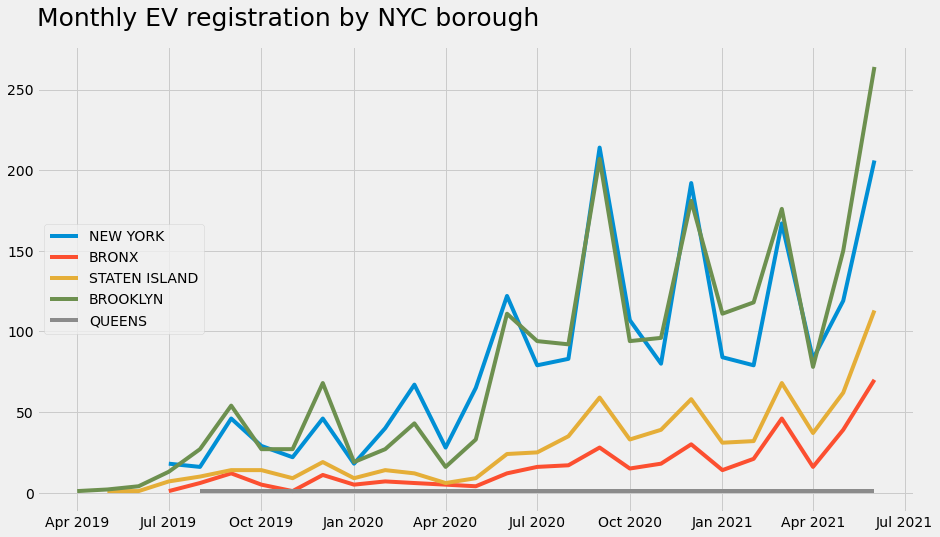

In [74]:
mpl.style.use('fivethirtyeight')
nyc_monthly = nyc_date.groupby(['city', 'date_my']).sum().reset_index()
fig_full, ax_full = plt.subplots(1, 1, figsize=(14, 8))
nyc_monthly.sort_values('date_my', inplace=True)
for bor in nyc_bor:
    bor_df = nyc_monthly.loc[nyc_monthly['city'] == bor]
    ax_full.plot(bor_df['date_my'].values, bor_df['count'].values, label=bor)
ax_full.legend(loc='center left')
ax_full.xaxis.set_major_formatter(mdates.DateFormatter('%b %Y'))
ax_full.set_title('Monthly EV registration by NYC borough', fontsize=25, pad=20, loc='left')

Next we included makes in our groupby statement, filtering only non-Tesla EVs.

In [75]:
query = """
SELECT COUNT(*) count, City city, `Reg Valid Date` reg_date, Make make FROM elec_pass
GROUP BY city, reg_date, make
HAVING make != 'TESLA'
ORDER BY count DESC
"""

elec_city_non_tesla = pd.DataFrame([x.asDict() for x in spark.sql(query).collect()])

Again, we filtered to include only NYC registrations.

In [76]:
nyc_non_tesla = elec_city_non_tesla.loc[elec_city_non_tesla['city'].isin(nyc_bor)]

We again extracted the month and year, then combined these into a datetime object.

In [77]:
nyc_non_tesla['month'] = nyc_non_tesla['reg_date'].map(lambda x: int(x[:2]))
nyc_non_tesla['year'] = nyc_non_tesla['reg_date'].map(lambda x: int(x[-4:]))
nyc_non_tesla['date_my'] = pd.to_datetime(nyc_non_tesla.apply(lambda x: str(x['month']) + ' ' + str(x['year']), axis=1), format='%m %Y')

<ipython-input-77-46e81c908576>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  nyc_non_tesla['month'] = nyc_non_tesla['reg_date'].map(lambda x: int(x[:2]))
<ipython-input-77-46e81c908576>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  nyc_non_tesla['year'] = nyc_non_tesla['reg_date'].map(lambda x: int(x[-4:]))
<ipython-input-77-46e81c908576>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cave

We plotted non-Tesla EV registration by borough. In this case, Manhattan (New York) had the highest number of registrations most recently and the gap between Manhattan and Brooklyn and the other boroughs is not so wide.

Text(0.0, 1.0, 'Monthly non-Tesla EV registration by NYC borough')

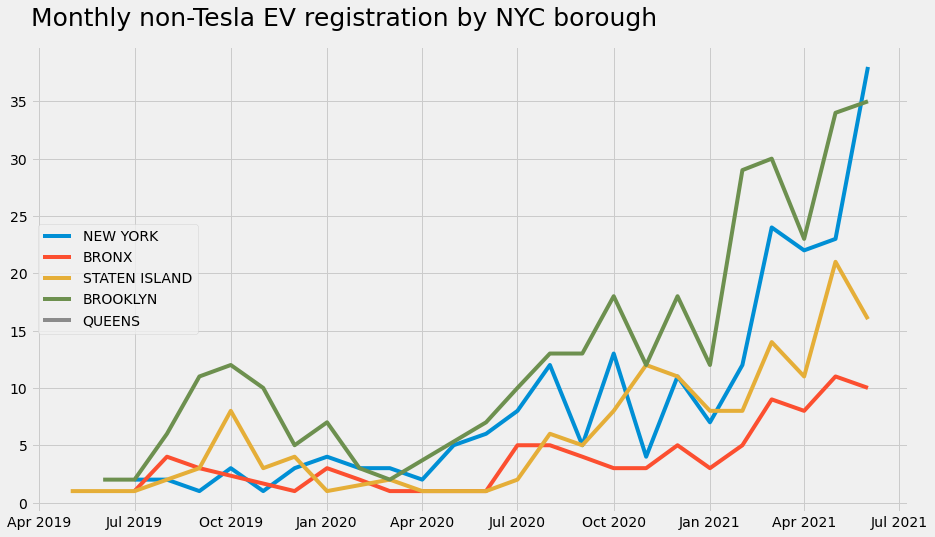

In [78]:
nyc_monthly_non_tesla = nyc_non_tesla.groupby(['city', 'date_my']).sum().reset_index()
fig_non_tesla, ax_non_tesla = plt.subplots(1, 1, figsize=(14, 8))
nyc_monthly_non_tesla.sort_values('date_my', inplace=True)
for bor in nyc_bor:
    bor_df = nyc_monthly_non_tesla.loc[nyc_monthly_non_tesla['city'] == bor]
    ax_non_tesla.plot(bor_df['date_my'].values, bor_df['count'].values, label=bor)
ax_non_tesla.legend(loc='center left')
ax_non_tesla.xaxis.set_major_formatter(mdates.DateFormatter('%b %Y'))
ax_non_tesla.set_title('Monthly non-Tesla EV registration by NYC borough', fontsize=25, pad=20, loc='left')

Next we grouped by model year as well.

In [79]:
query = """
SELECT COUNT(*) num_reg, `Model Year` model_year, `Reg Valid Date` reg_date, City city FROM elec_pass
GROUP BY model_year, reg_date, city
ORDER BY num_reg DESC
"""
year_model = pd.DataFrame([x.asDict() for x in spark.sql(query).collect()])

The registration year and model year were then extracted and formed into datetime objects for plotting.

In [80]:
year_model['reg_year'] = pd.to_datetime(year_model['reg_date'].map(lambda x: x[-4:]), format='%Y')
year_model['model_year'] = pd.to_datetime(year_model['model_year'], format='%Y')

In [81]:
year_model.head()

,num_reg,model_year,reg_date,city,reg_year
0,20,2021-01-01,06/18/2021,BROOKLYN,2021-01-01
1,17,2021-01-01,06/11/2021,BROOKLYN,2021-01-01
2,16,2020-01-01,06/30/2020,BROOKLYN,2020-01-01
3,14,2021-01-01,01/11/2021,BROOKLYN,2021-01-01
4,14,2020-01-01,09/25/2020,NEW YORK,2020-01-01


A final chart was created to illustrate the number of registrations by model year by borough. Again, the boroughs with the highest number of registrations were Manhattan and Brooklyn. The number of registrations by model year lowered in Manhattan for 2021 models.

In [82]:
nyc_yearly = year_model.groupby(['model_year', 'city'])['num_reg'].sum().reset_index()
nyc_yearly = nyc_yearly.loc[nyc_yearly['city'].isin(['QUEENS', 'BROOKLYN', 'BRONX', 'STATEN ISLAND', 'NEW YORK'])]
nyc_yearly['city'] = nyc_yearly['city'].str.title().replace({'New York', 'Manhattan'})
nyc_yearly = nyc_yearly.loc[nyc_yearly['model_year'].dt.year.between(2011, 2021)]
nyc_city_sort = nyc_yearly.loc[nyc_yearly['model_year'].dt.year == nyc_yearly['model_year'].dt.year.max()]
nyc_city_sort = nyc_city_sort.sort_values('num_reg', ascending=False)['city'].tolist()

alt.themes.enable('fivethirtyeight')
alt.Chart(nyc_yearly, title=['Registrations of EVs have increased', 'greatly since 2019 models']).mark_line().encode(
    x=alt.X('model_year:T', title=None),
    y=alt.Y('num_reg:Q', title=None),
    color=alt.Color('city:N', title='Borough', sort=nyc_city_sort)

)



alt.Chart(...)

# Additional resources


NY State Registration Database Metadata: [Reg Meta](https://data.ny.gov/Transportation/Vehicle-Snowmobile-and-Boat-Registrations/w4pv-hbkt)

[Data Dictionary](https://data.ny.gov/api/views/w4pv-hbkt/files/AUsdC2Y0iEymGyebFASIjDxZ7irrm1-_yS-o9qFzWTQ?download=true&filename=NYSDMV_VehicleSnowmobileAndBoat_Registration_Data%20Dictionary.pdf)

shell-init: error retrieving current directory: getcwd: cannot access parent directories: No such file or directory
The folder you are executing pip from can no longer be found.
